# Heat maps for first four moments + FCA

# the DIFFERENCES between the upstream and the downstream region

In [1]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import holoviews as hv
%reload_ext holoviews.ipython

Read in the data:

In [3]:
import scipy.io
data = scipy.io.loadmat('/Users/nataliabielczyk/Downloads/all_moments.mat')
data1 = scipy.io.loadmat('/Users/nataliabielczyk/Downloads/all_moments_innovation.mat')
data_timeseries = scipy.io.loadmat('/Users/nataliabielczyk/Downloads/all_moments_timeseries_innovation.mat')

# Make heat maps for the first four moments + FCA for the TIME SERIES:

In [4]:
xticks = np.arange(0.1,1.1,0.1) # innovation in the downstream region
yticks = [(0, '0.1'), (1, '0.2'), (2, '0.25'), (3, '0.33'), (4, '0.5'), (5, '1'), (6, '2'), (7, '3'), (8, '4'), (9, '5'), (10, '10')] #disproportion
weight = np.arange(0.1,1.1,0.1)
thresh = np.arange(-2.00,3.01,0.01)

In [12]:
%%opts Image (cmap='RdBu_r' interpolation='nearest') [colorbar=True invert_yaxis=False aspect='square' apply_ticks=True yticks=yticks] {+axiswise}
items3D1e = {} 
items3D2e = {}
items3D3e = {}
items3D4e = {}
items3D1i = {}
items3D2i = {}
items3D3i = {}
items3D4i = {}
for n in range(10): #first slider: connection weight
        def get_image3D(mat, label, n):
            mat = mat[n, :, :]
            mat = np.flipud(mat.transpose())
            return hv.Image(mat, label=label, bounds=[0,0,1,10],
                 kdims=['innovations strength, downstream', 'disproportion in innovations: up-/down-'], 
                 vdims=[hv.Dimension('', range=(-np.max(np.abs(mat)), np.max(np.abs(mat))))])

        im3D1e = get_image3D(data_timeseries['mean_full_excitatory_diff'], "excitatory connection, mean", n)
        im3D2e = get_image3D(data_timeseries['var_full_excitatory_diff'], "excitatory connection, variance", n)
        im3D3e = get_image3D(data_timeseries['skewness_full_excitatory_diff'], "excitatory connection, skewness", n)
        im3D4e = get_image3D(data_timeseries['kurtosis_full_excitatory_diff'], "excitatory connection, kurtosis", n)
        im3D1i = get_image3D(data_timeseries['mean_full_inhibitory_diff'], "inhibitory connection, mean", n)
        im3D2i = get_image3D(data_timeseries['var_full_inhibitory_diff'], "inhibitory connection, variance", n)
        im3D3i = get_image3D(data_timeseries['skewness_full_inhibitory_diff'], "inhibitory connection, skewness", n)
        im3D4i = get_image3D(data_timeseries['kurtosis_full_inhibitory_diff'], "inhibitory connection, kurtosis", n)

        items3D1e[weight[n]] = im3D1e
        items3D2e[weight[n]] = im3D2e
        items3D3e[weight[n]] = im3D3e
        items3D4e[weight[n]] = im3D4e
        items3D1i[weight[n]] = im3D1i
        items3D2i[weight[n]] = im3D2i
        items3D3i[weight[n]] = im3D3i
        items3D4i[weight[n]] = im3D4i
        
hmap3D1e = hv.HoloMap(items3D1e, kdims=['connectivity weight'])
hmap3D2e = hv.HoloMap(items3D2e, kdims=['connectivity weight'])
hmap3D3e = hv.HoloMap(items3D3e, kdims=['connectivity weight'])
hmap3D4e = hv.HoloMap(items3D4e, kdims=['connectivity weight'])
hmap3D1i = hv.HoloMap(items3D1i, kdims=['connectivity weight'])
hmap3D2i = hv.HoloMap(items3D2i, kdims=['connectivity weight'])
hmap3D3i = hv.HoloMap(items3D3i, kdims=['connectivity weight'])
hmap3D4i = hv.HoloMap(items3D4i, kdims=['connectivity weight'])

:Layout
   .HoloMap.Excitatory_connection_comma_mean     :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Excitatory_connection_comma_variance :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Excitatory_connection_comma_skewness :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Excitatory_connection_comma_kurtosis :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
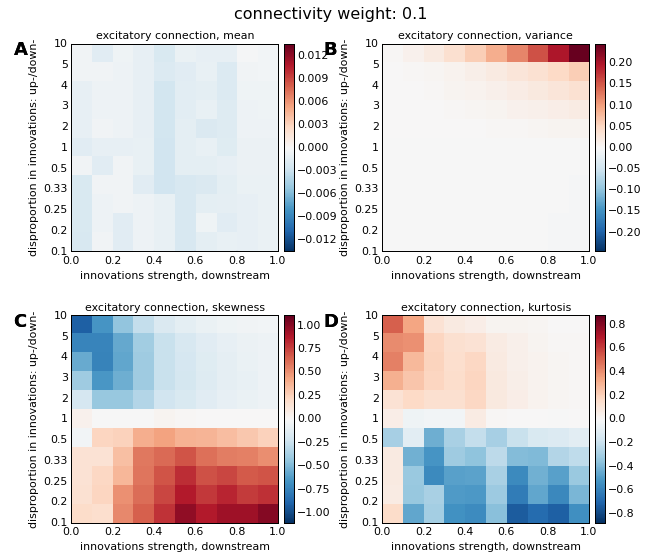
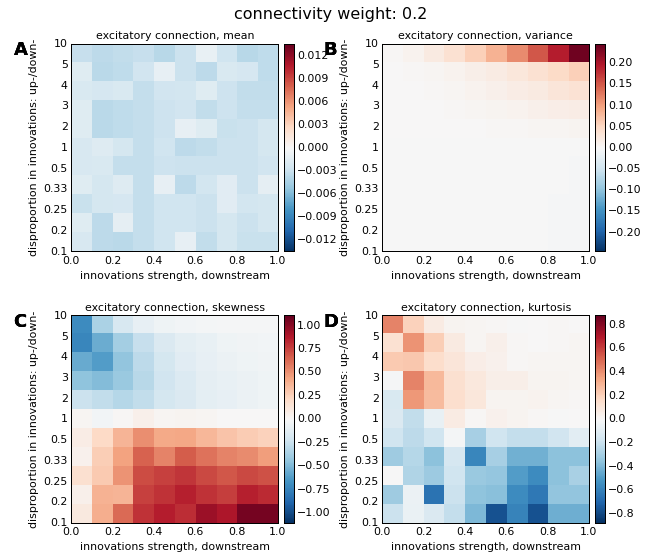
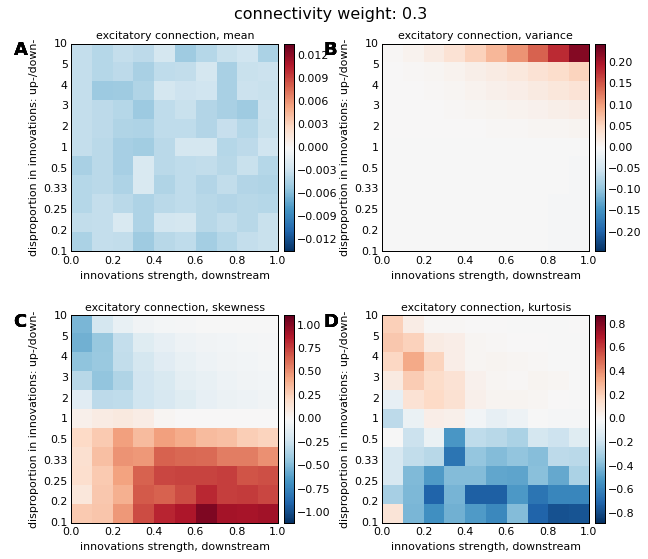
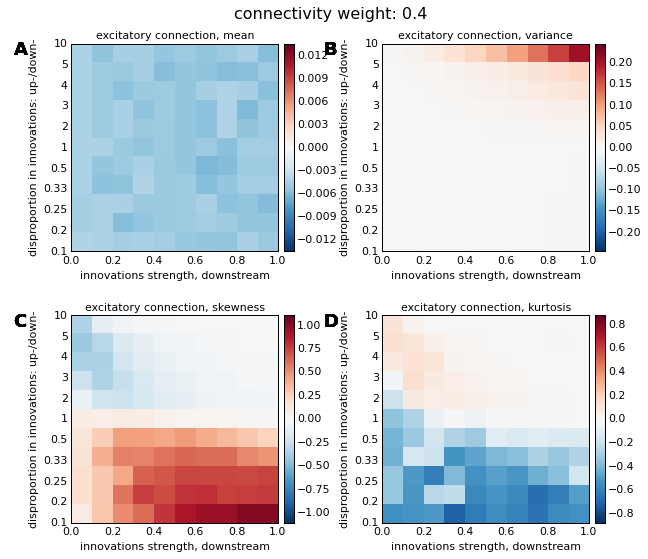
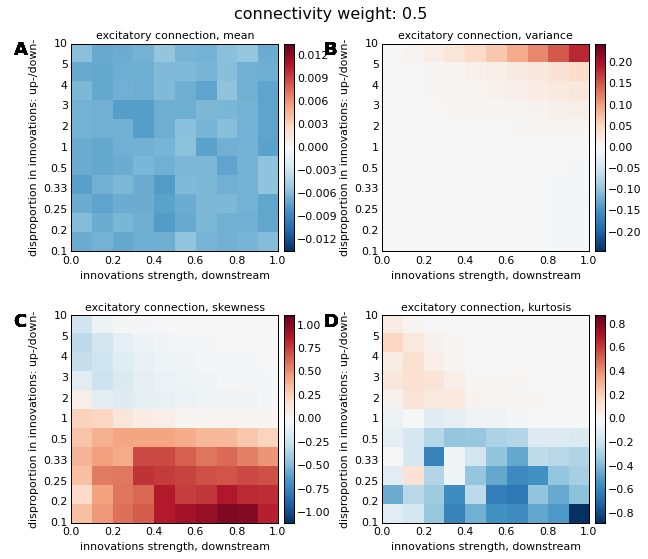
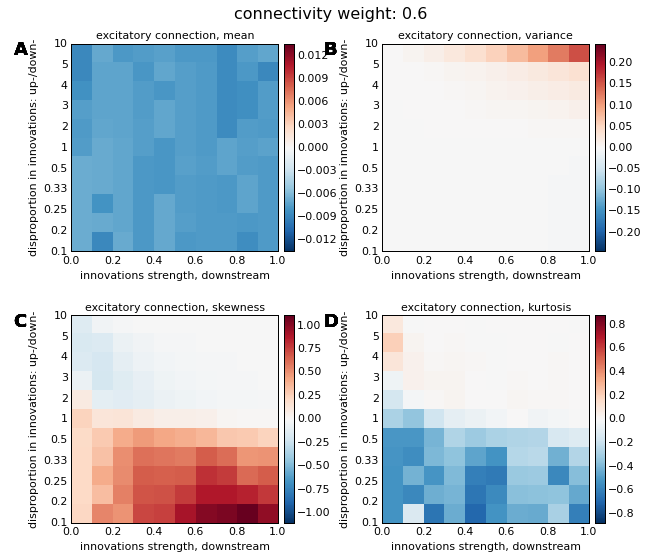
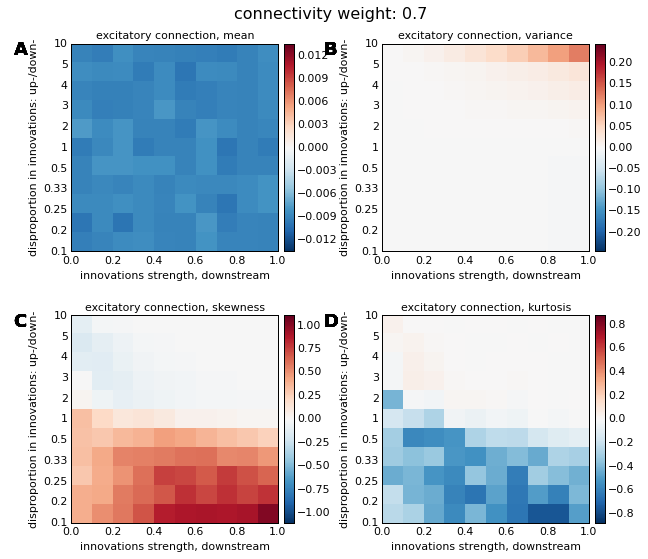
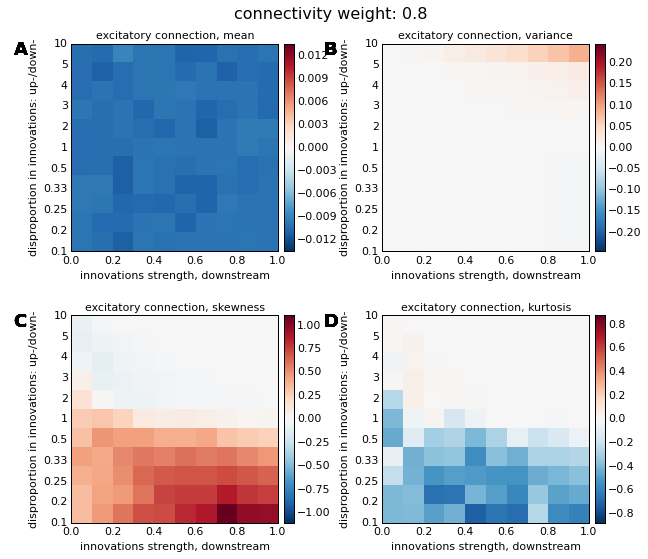
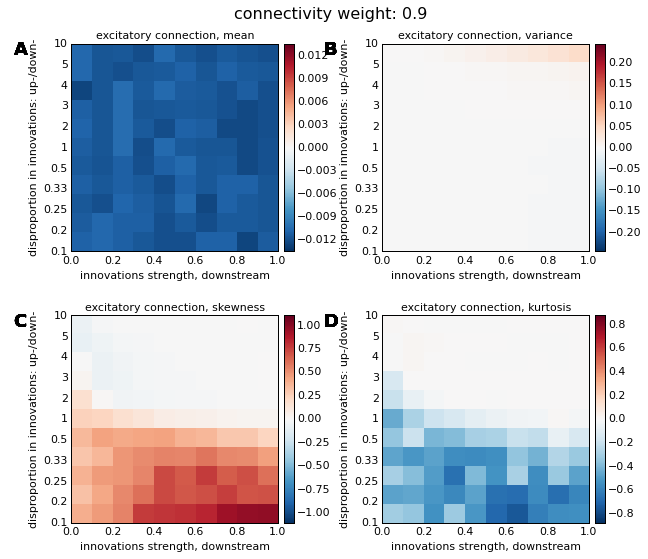
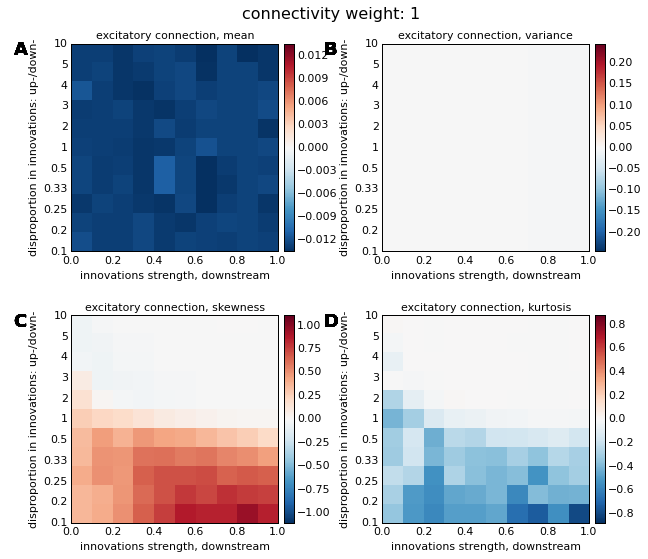

In [13]:
%%output max_frames=20000
(hmap3D1e + hmap3D2e + hmap3D3e + hmap3D4e).cols(2)

:Layout
   .HoloMap.Inhibitory_connection_comma_mean     :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Inhibitory_connection_comma_variance :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Inhibitory_connection_comma_skewness :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
   .HoloMap.Inhibitory_connection_comma_kurtosis :HoloMap   [connectivity weight]
      :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
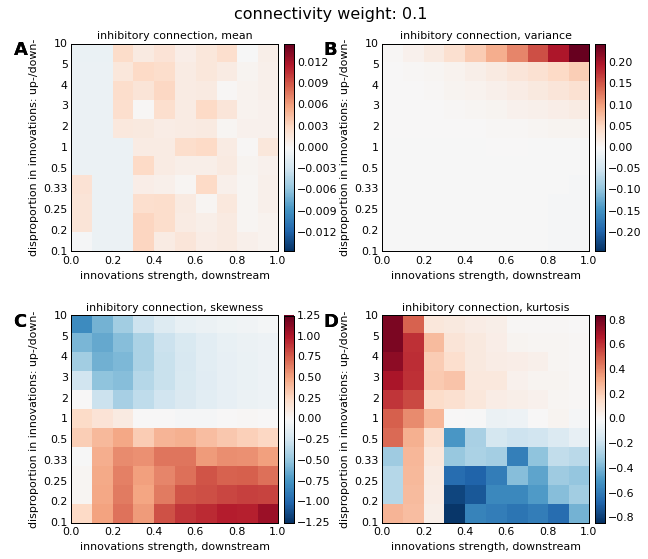
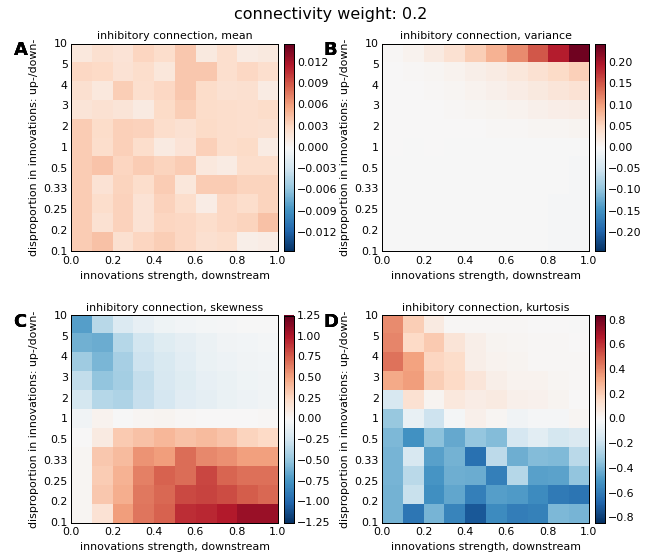
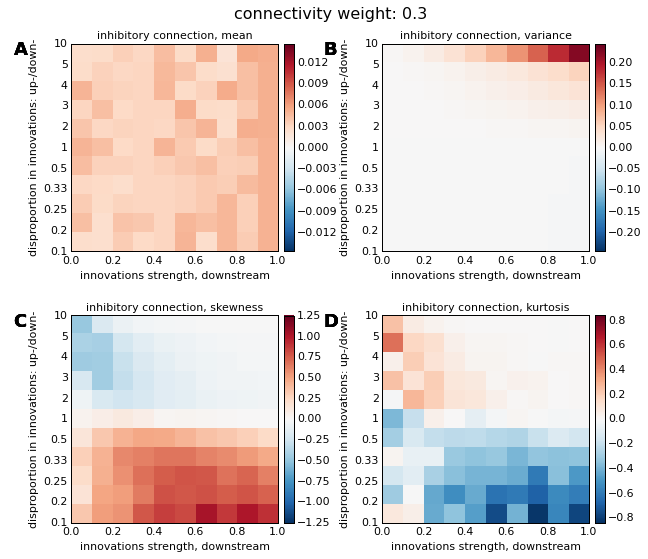
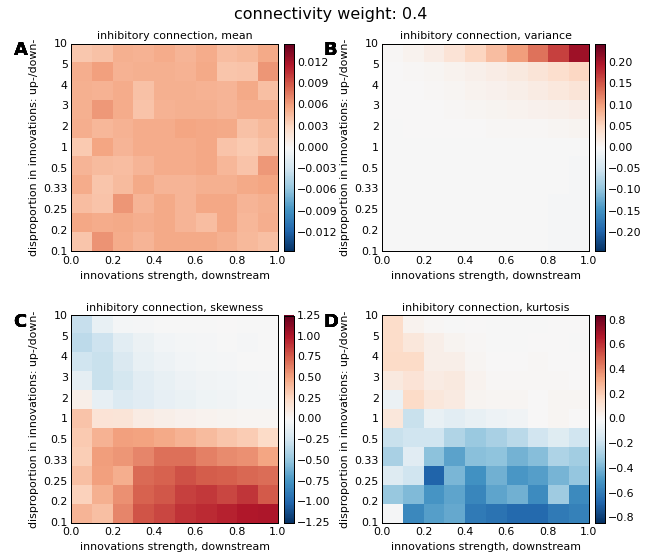
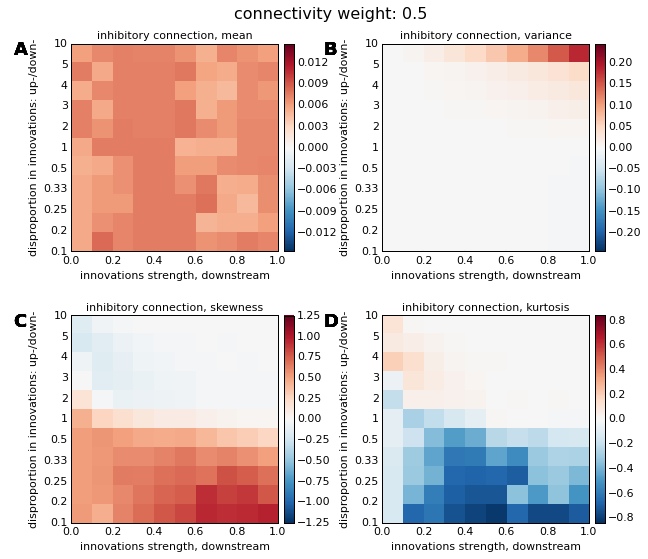
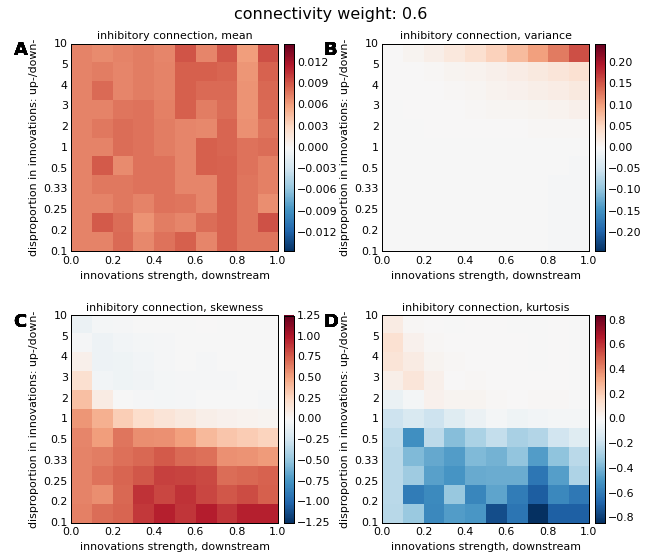
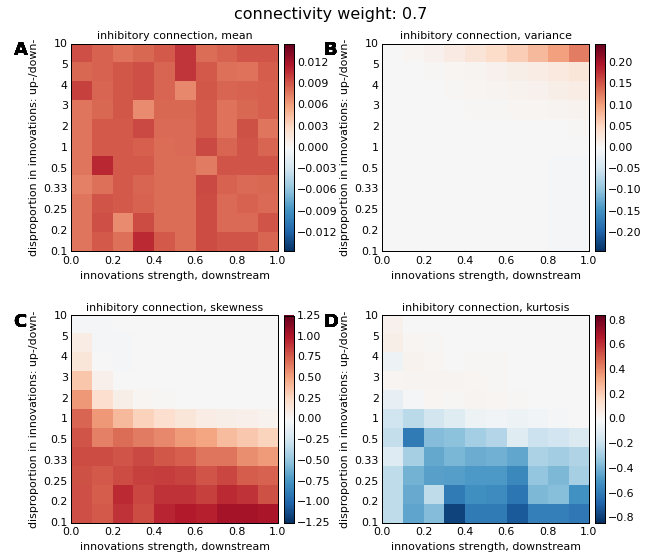
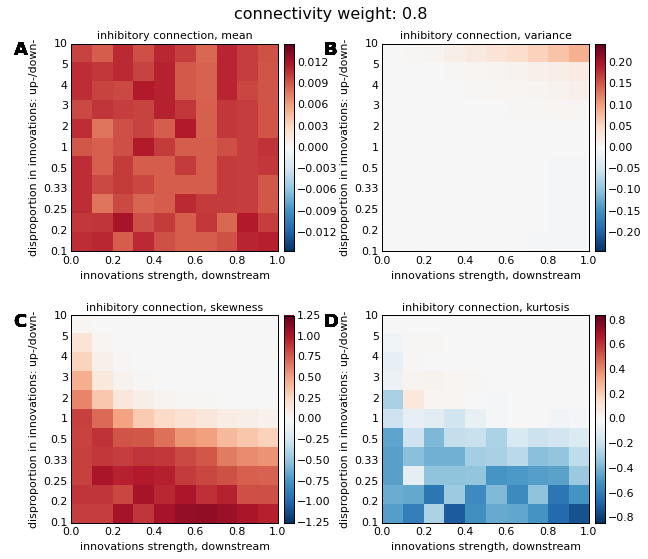
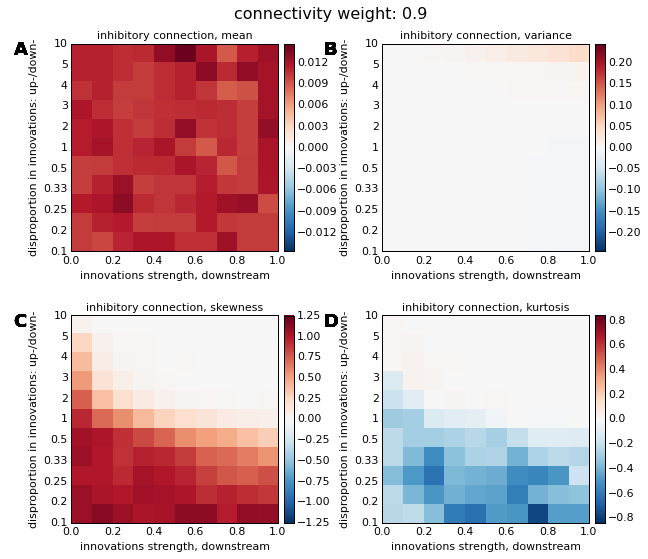
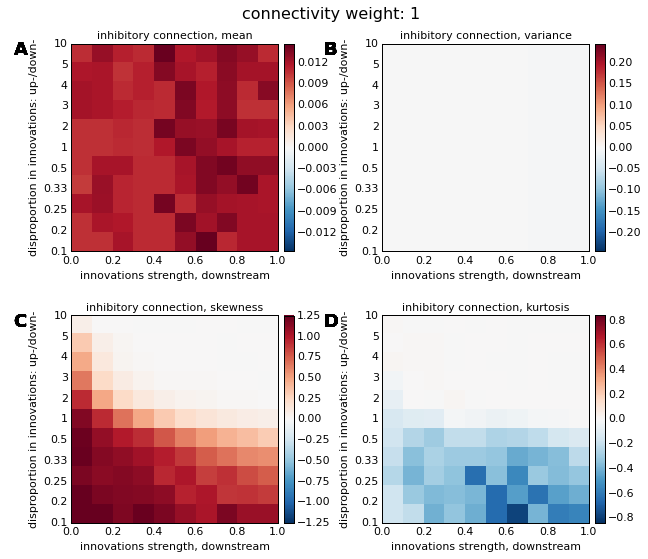

In [14]:
%%output max_frames=20000
%%opts Image (cmap='RdBu_r' interpolation='nearest') [colorbar=True invert_yaxis=False aspect='square' apply_ticks=True yticks=yticks] {+axiswise}
(hmap3D1i + hmap3D2i + hmap3D3i + hmap3D4i).cols(2)

In [10]:
%%opts Image (cmap='RdBu_r' interpolation='nearest') [colorbar=True invert_yaxis=False aspect='square' apply_ticks=True yticks=yticks] {+axiswise}
items1 = {} 
items2 = {}
for n in range(10): #first slider: connection weight
    for m in range(501): #second slider: FCA threshold
        def get_image4D(mat, label, n, m):
            mat = mat[n, :, :, m]
            mat = np.fliplr(mat).transpose()
            return hv.Image(mat, label=label, bounds=[0,0,1,10],
                 kdims=['innovations strength, downstream', 'disproportion in innovations: up-/down-'], 
                 vdims=[hv.Dimension('', range=(-np.max(np.abs(mat)), np.max(np.abs(mat))))])

        im1 = get_image4D(data_timeseries['fc_full_allthresholds_excitatory_diff'], "excitatory connection, FCA for all thresholds", n, m)
        im2 = get_image4D(data_timeseries['fc_full_allthresholds_inhibitory_diff'], "inhibitory connection, FCA for all thresholds", n, m)

        items1[weight[n], thresh[m]] = im1
        items2[weight[n], thresh[m]] = im2
        
hmap1 = hv.HoloMap(items1, kdims=['connectivity weight','z-score threshold, FCA'])
hmap2 = hv.HoloMap(items2, kdims=['connectivity weight','z-score threshold, FCA'])

:HoloMap   [connectivity weight,z-score threshold, FCA]
   :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
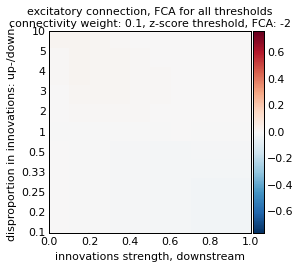
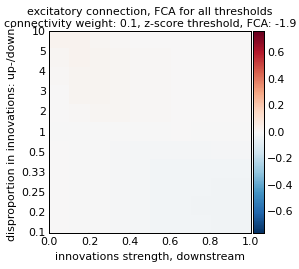
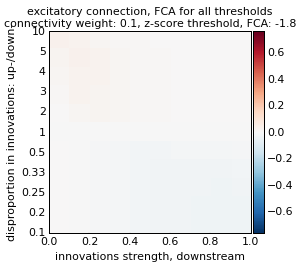
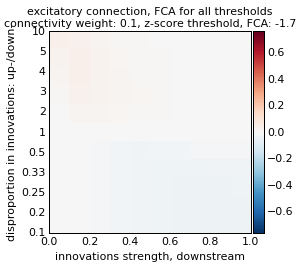
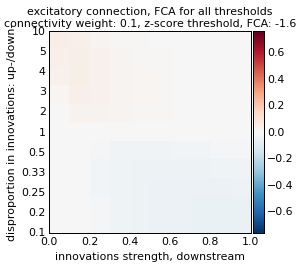
...
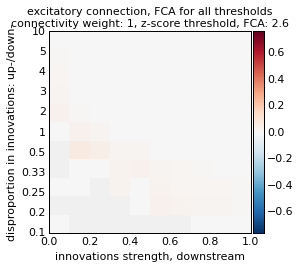
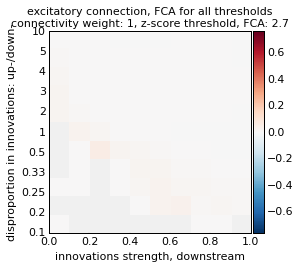
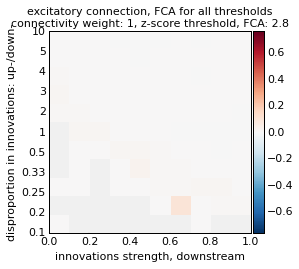
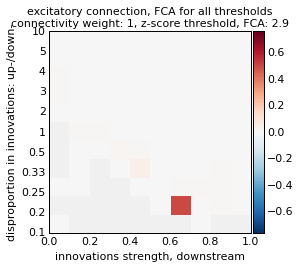
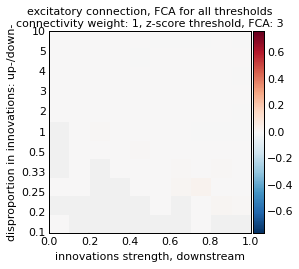

In [6]:
%%output max_frames=20000
#borders = (0.0, 0.0, 0.1, 5.5)
#scene1 = hmap1[:, ::10]
#scene2 = hmap2[:, ::10]
#from holoviews import Bounds
#(scene1 * Bounds(borders) + scene2 * Bounds(borders)).cols(2)
hmap1[:, ::10]

:HoloMap   [connectivity weight,z-score threshold, FCA]
   :Image   [innovations strength, downstream,disproportion in innovations: up-/down-]   ()
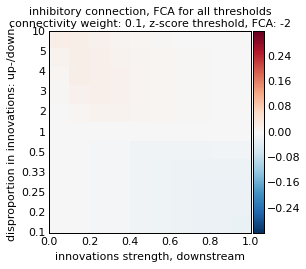
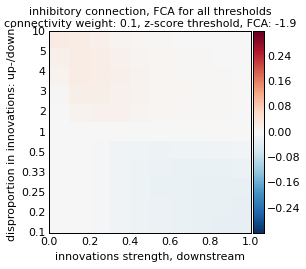
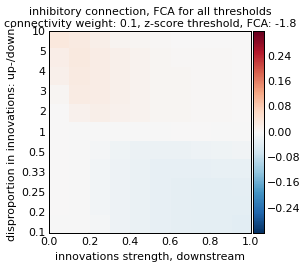
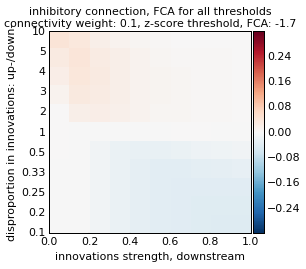
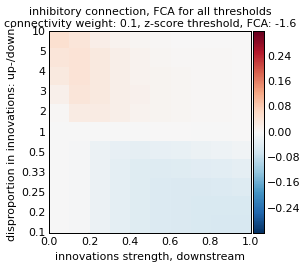
...
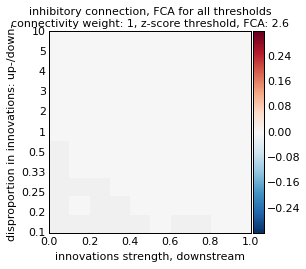
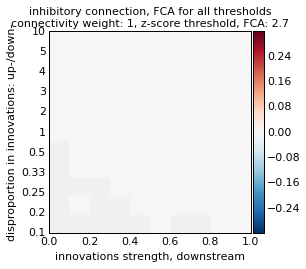
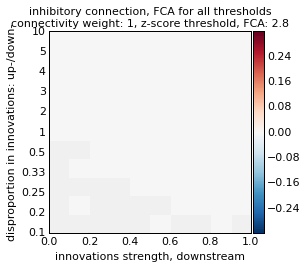
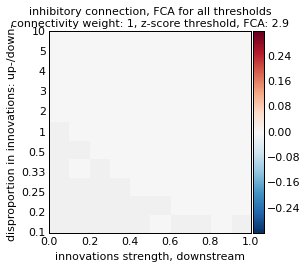
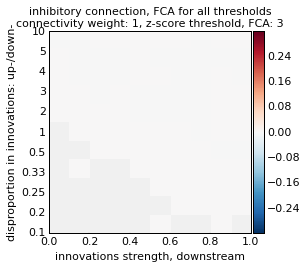

In [11]:
%%opts Image (cmap='RdBu_r' interpolation='nearest') [colorbar=True invert_yaxis=False aspect='square' apply_ticks=True yticks=yticks] {+axiswise}
%%output max_frames=20000
hmap2[:, ::10]